# Stable Diffusion with Diffusers

In [1]:
# !pip install -Uq diffusers transformers fastcore

In [2]:
import torch
from diffusers import StableDiffusionPipeline
pipe = StableDiffusionPipeline.from_pretrained('CompVis/stable-diffusion-v1-4',
                                               variant='fp16',
                                               torch_dtype=torch.float16,
                                               use_auth_token=True).to('cuda')
image = pipe('An astronaught scuba diving')
image

/home/agastya/mambaforge/lib/python3.10/site-packages/transformers/utils/generic.py:311: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
/home/agastya/mambaforge/lib/python3.10/site-packages/transformers/utils/generic.py:311: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
Keyword arguments {'use_auth_token': True} are not expected by StableDiffusionPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

StableDiffusionPipelineOutput(images=[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0659E7D180>], nsfw_content_detected=[False])

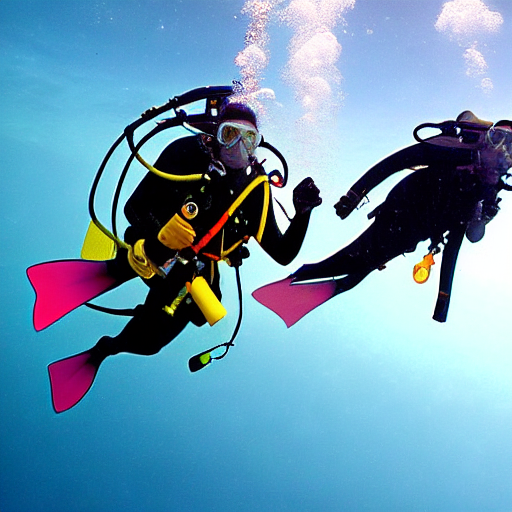

In [3]:
image[0][0]

## Using Stable Diffusion

In [4]:
import logging
from pathlib import Path

import matplotlib.pyplot as plt
import torch
from diffusers import StableDiffusionPipeline
from fastcore.all import concat
from huggingface_hub import notebook_login
from PIL import Image

logging.disable(logging.WARNING)

torch.manual_seed(1)
if not(Path.home()/'.cache/huggingface'/'token').exists():
    notebook_login()

`StableDiffusionPipeline` is an end-to-end diffusion inference pipeline which allows you to generate images with just few lines of code.
What is Pipeline? Libraries like Hugging face and scikit-learn use concept of "pipeline" to indicate sequence of step when combined completes some task.


In [5]:
pipe = StableDiffusionPipeline.from_pretrained('CompVis/stable-diffusion-v1-4',
                                               variant='fp16',  # Half precisions of weight
                                               torch_dtype=torch.float16,
                                               use_auth_token=True).to('cuda')

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [6]:
!ls ~/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4	version.txt
models--pcuenq--jh_dreambooth_1000	version_diffusers_cache.txt


In [7]:
!cat ~/.cache/huggingface/hub/version.txt

1

  0%|          | 0/50 [00:00<?, ?it/s]

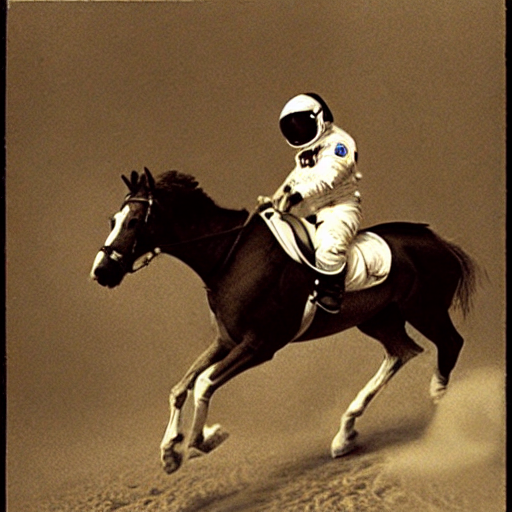

In [8]:
prompt = "a photograph of an astronaut riding a horse"
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

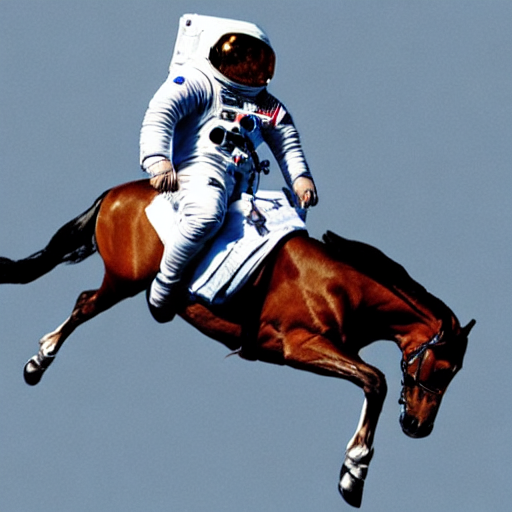

In [9]:
torch.manual_seed(1024)
pipe(prompt).images[0]

In [10]:
def image_grid(imgs, rows, cols):
    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

Setting steps to 3 which shows initial state of image 

  0%|          | 0/3 [00:00<?, ?it/s]

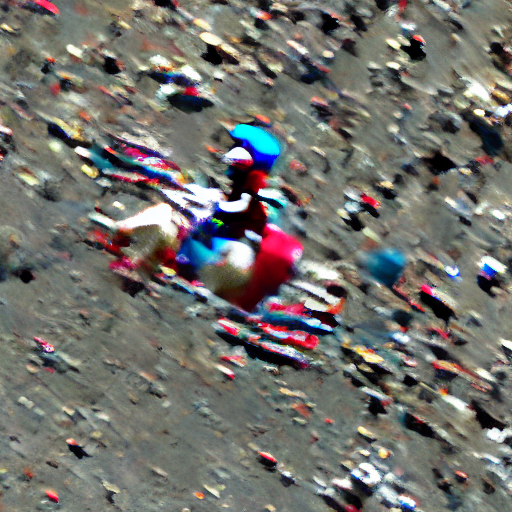

In [11]:
torch.manual_seed(1024)
pipe(prompt, num_inference_steps=3).images[0]

SD for each step of reverse diffusion

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/60 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/90 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/110 [00:00<?, ?it/s]

  0%|          | 0/120 [00:00<?, ?it/s]

  0%|          | 0/130 [00:00<?, ?it/s]

  0%|          | 0/140 [00:00<?, ?it/s]

  0%|          | 0/150 [00:00<?, ?it/s]

  0%|          | 0/160 [00:00<?, ?it/s]

  0%|          | 0/170 [00:00<?, ?it/s]

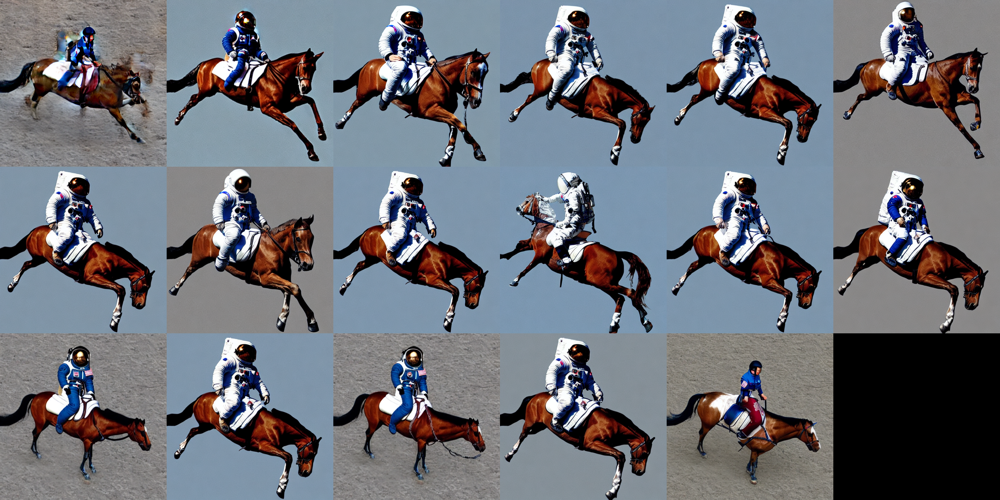

In [12]:
# torch.manual_seed(1024)
num_rows, num_cols = 3,6
images = []
for i in range(1, num_rows*num_cols):
    #seed context is lost outside of for loop resulting 
    # in different initial stage for the latent image
    torch.manual_seed(1024)
    img = pipe(prompt, num_inference_steps=i*10).images[0]
    images.append(img)
image_grid(images, num_rows, num_cols)

  0%|          | 0/16 [00:00<?, ?it/s]

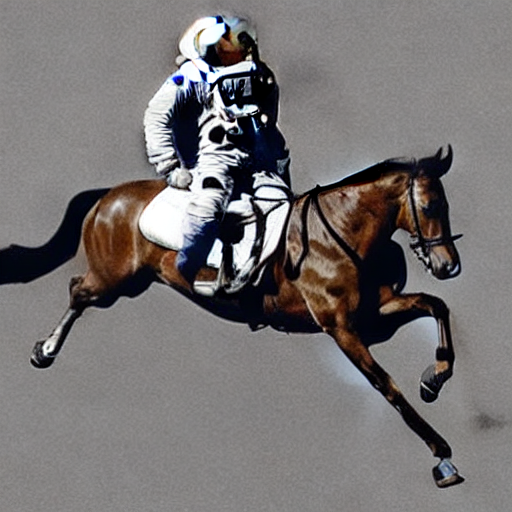

In [13]:
# Looks somewhat similar to the first image with higher steps
torch.manual_seed(1024)   # why do we have to redefine seed in each cell?
pipe(prompt, num_inference_steps=16).images[0]

## Classifier-Free Guidance
It is a method to increase the adherence of the output to the *conditioning signal* we used (text)
Larger guidance scale -> more the model tries to represent the text prompt and it is less diverse.
https://benanne.github.io/2022/05/26/guidance.html

In [14]:
num_rows,num_cols = 4,5
prompts = [prompt] * num_cols

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

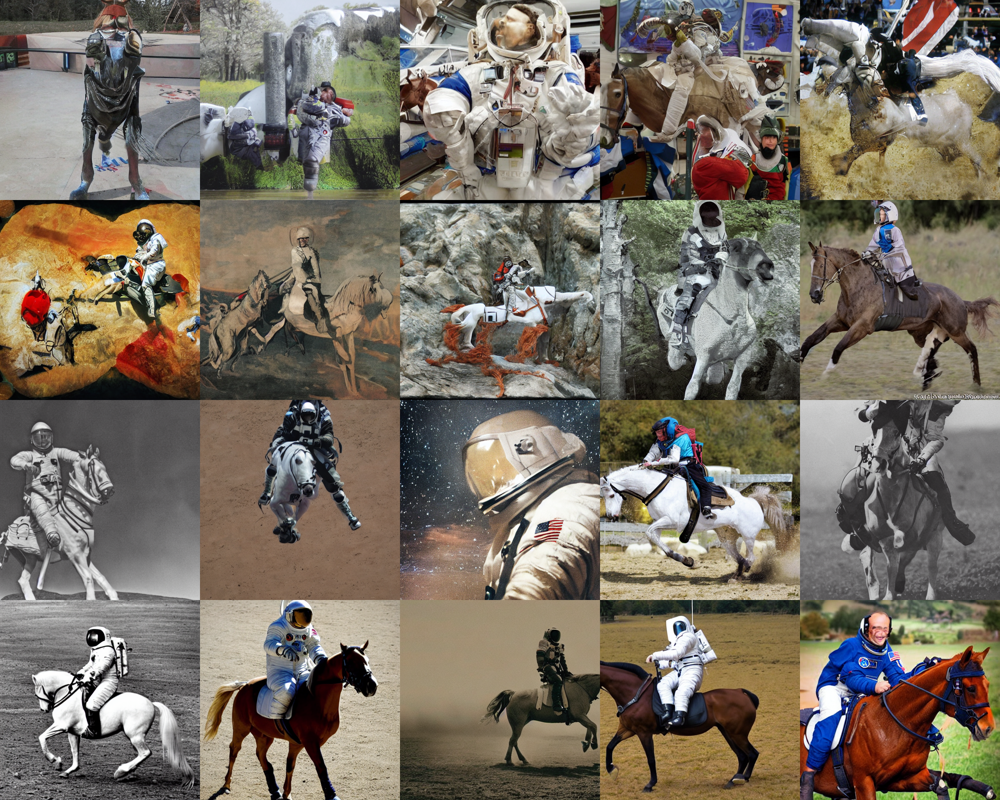

In [15]:
images = concat(pipe(prompts, guidance_scale=g).images for g in [0, 1.1, 3, 7, 14])
image_grid(images, rows=num_rows, cols=num_cols)

## Negative prompts
Negative prompting refers to the use of another prompt (instead of a completely unconditioned generation), and scaling the difference between generations of that prompt and the conditioned generation.

  0%|          | 0/50 [00:00<?, ?it/s]

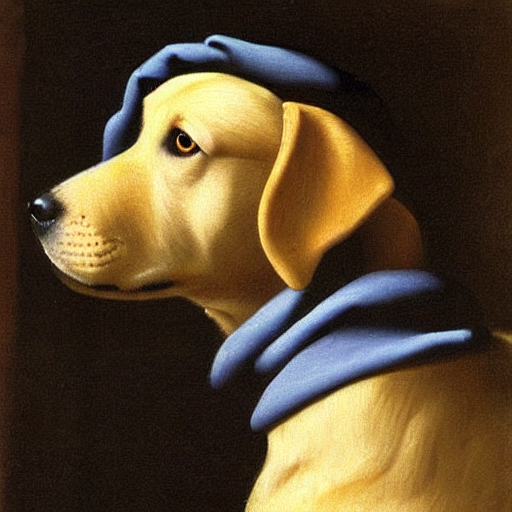

In [16]:
torch.manual_seed(1000)
prompt = 'Labrador in the style of Vermeer'
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

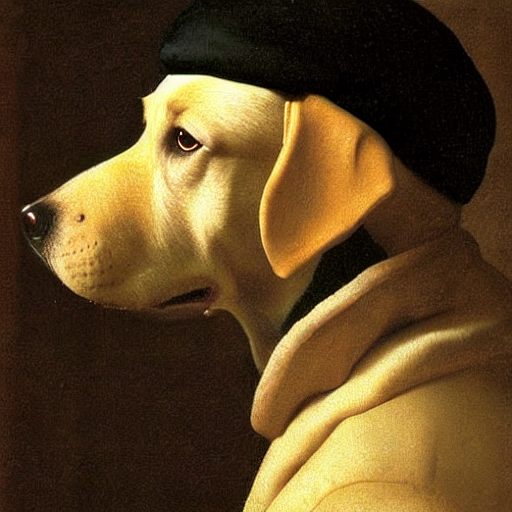

In [17]:
torch.manual_seed(1000)
pipe(prompt, negative_prompt="blue").images[0]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

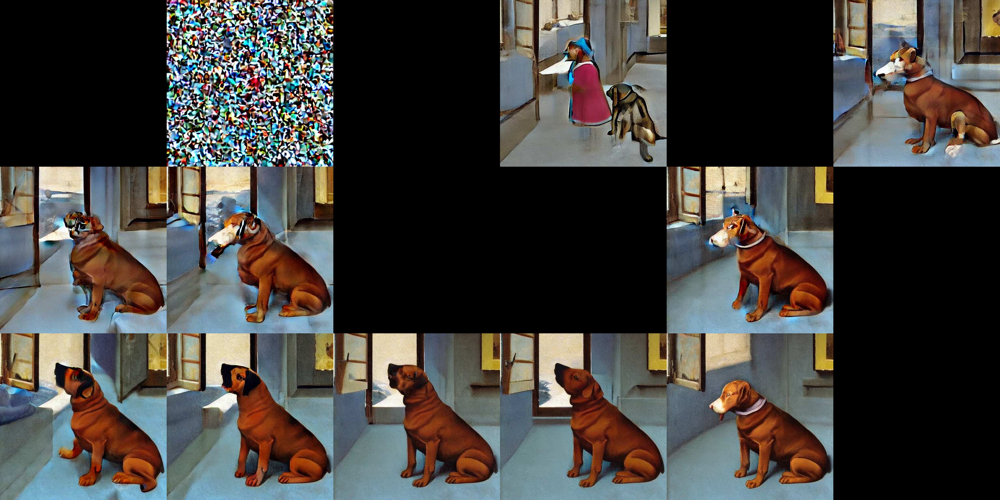

In [18]:
# torch.manual_seed(1024)
num_rows, num_cols = 3,6
images = []
for i in range(1, num_rows*num_cols):
    #seed context is lost outside of for loop resulting 
    # in different initial stage for the latent image
    torch.manual_seed(1024)
    img = pipe(prompt, num_inference_steps=i).images[0]
    images.append(img)
image_grid(images, num_rows, num_cols)

## Image to Image
SD was trained to generate images,and optionally drive the generation using textual conditioning. We can use the raw image diffusion process for other task.

For example, instead of starting from pure noise, we can start from an image an add a certain amount of noise to it. We are replacing the initial steps of the denoising and pretending our image is what the algorithm came up with. Then we continue the diffusion process from that state as usual.

This usually preserves the composition although details may change a lot. It's great for sketches!

These operations (provide an initial image, add some noise to it and run diffusion from there) can be automatically performed by a special image to image pipeline: StableDiffusionImg2ImgPipeline. This is the source code for its __call__ method.

In [19]:
from diffusers import StableDiffusionImg2ImgPipeline
from fastdownload import FastDownload

In [20]:
pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4",
    variant="fp16",
    torch_dtype = torch.float16).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

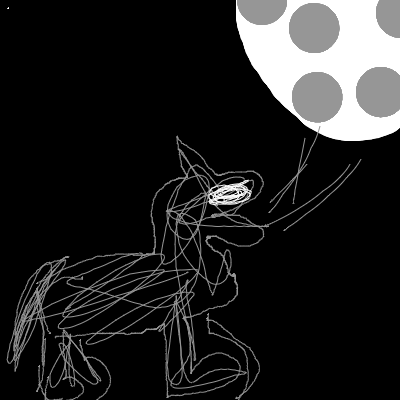

In [21]:
p = FastDownload().download('https://cdn-uploads.huggingface.co/production/uploads/1664665907257-noauth.png')
init_image = Image.open(p).convert("RGB")
init_image

In [22]:
import gc
def report_gpu():
    # print(torch.cuda.list_gpu_processes())
    gc.collect()
    torch.cuda.empty_cache()

  0%|          | 0/40 [00:00<?, ?it/s]

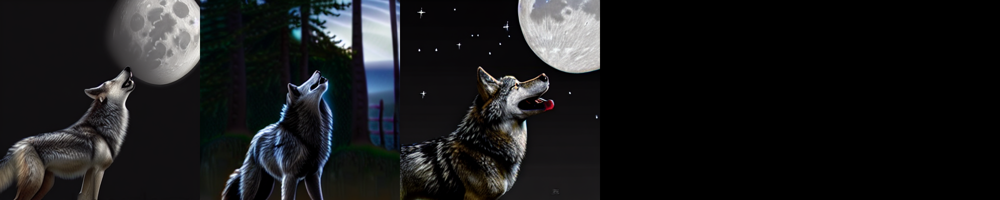

In [24]:
torch.manual_seed(1000)
prompt = "Wolf howling at the moon, photorealistic 4k"
images = pipe(prompt=prompt, num_images_per_prompt=3, image=init_image, strength=0.8, num_inference_steps=50).images
image_grid(images, rows=1, cols=5)

In [25]:
report_gpu()

/home/agastya/mambaforge/lib/python3.10/site-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion_img2img.py:766: FutureWarning: You have passed 6 text prompts (`prompt`), but only 1 initial images (`image`). Initial images are now duplicating to match the number of text prompts. Note that this behavior is deprecated and will be removed in a version 1.0.0. Please make sure to update your script to pass as many initial images as text prompts to suppress this warning.
  deprecate("len(prompt) != len(image)", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/40 [00:00<?, ?it/s]

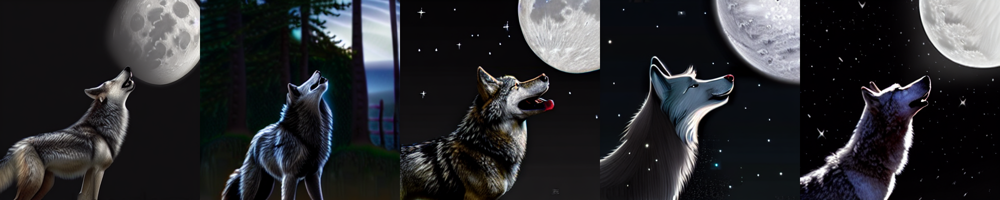

In [26]:
torch.manual_seed(1000)
prompt = "Wolf howling at the moon, photorealistic 4k"
images = pipe(prompt=prompt, num_images_per_prompt=num_cols, image=init_image, strength=0.8, num_inference_steps=50).images
image_grid(images, rows=1, cols=5)

  0%|          | 0/70 [00:00<?, ?it/s]

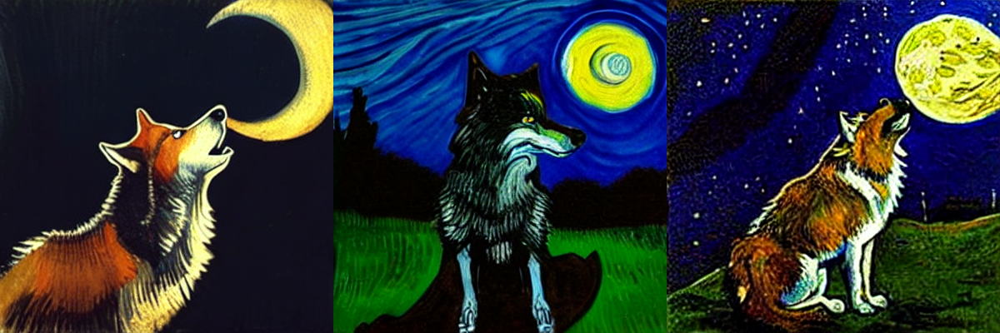

In [27]:
init_image = images[2]
torch.manual_seed(1000)
prompt = 'Oil painting of wolf howling at the moon by Van Gogh'
images = pipe(prompt=prompt, num_images_per_prompt=3, image=init_image, strength=1, num_inference_steps=70).images
image_grid(images, rows=1, cols=3)

## Textual Inversion

Textual Inversion is a process where we can "teach" a new word to the text model and train its embedding close to some visual representation. 
This is achieved by adding a new token to the vocabulary, freezing the weights of the models (except the text encoder), and train with a few representative images.


In [28]:
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4",
                                               variant = "fp16",
                                               torch_dtype = torch.float16).to('cuda')

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [29]:
embeds_url = "https://huggingface.co/sd-concepts-library/indian-watercolor-portraits/resolve/main/learned_embeds.bin"
embeds_path = FastDownload().download(embeds_url)
embeds_dict = torch.load(str(embeds_path), map_location="cpu")

In [30]:
len(embeds_dict['<watercolor-portrait>'])

768

Embedding for the new token are stored in a small PyTorch pickled dictionary, whose key is the new token that was trained.
Since the encoder of the pipeline doesn't know about this term, we will append it manually.

In [31]:
pipe

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.28.0",
  "_name_or_path": "CompVis/stable-diffusion-v1-4",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [32]:
tokenizer = pipe.tokenizer  #Converts the text into tokens
text_encoder = pipe.text_encoder  #Converts the tokens into embeddings of size 768
new_token, embeds = next(iter(embeds_dict.items()))

In [33]:
embeds = embeds.to(text_encoder.dtype) #Converting it into same datatype

  0%|          | 0/50 [00:00<?, ?it/s]

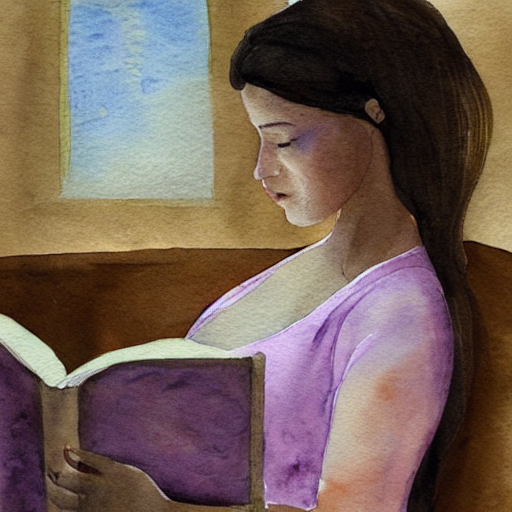

In [34]:
torch.manual_seed(1000)
image = pipe("Woman reading in the style of <watercolor-potrait>").images[0]
image

## Dreambooth
It is a kind of find tuning that attempts to introduce new subjects just by providing few images of the new subject. The goal is similar to the Textual inversion but the process is differe.

Instead of creating a new token as Textual inversion does.
We select an existing token in the vocabulary (usually a rarely used one), and fine-tune the model for a few hundred steps to bring that token close to the images we provide. This is a regular fine-tuning process in which all modules are unfrozen.



In [35]:
pipe = StableDiffusionPipeline.from_pretrained("pcuenq/jh_dreambooth_1000", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

pytorch_model.bin:  32%|###1      | 157M/492M [00:00<?, ?B/s]

pytorch_model.bin:   6%|6         | 73.4M/1.22G [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   3%|3         | 115M/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.bin:  44%|####3     | 147M/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [36]:
torch.manual_seed(1000)

prompt = "Painting of sks person in the style of Paul Signac"
images = pipe(prompt, num_images_per_prompt=4).images
image_grid(images, 1, 4)

  0%|          | 0/50 [00:00<?, ?it/s]

OutOfMemoryError: CUDA out of memory. Tried to allocate 160.00 MiB. GPU 0 has a total capacity of 6.00 GiB of which 0 bytes is free. Including non-PyTorch memory, this process has 17179869184.00 GiB memory in use. Of the allocated memory 5.24 GiB is allocated by PyTorch, and 40.12 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)